In [31]:
import pandas as pd
import geopandas as gpd
import numpy as np
from pysal.lib import weights
from splot.libpysal import plot_spatial_weights
from esda.moran import Moran, Moran_Local
from splot.esda import moran_scatterplot, plot_local_autocorrelation, lisa_cluster
import matplotlib.pyplot as plt
import folium
import matplotlib.colors as colors

In [4]:
# read in grid_1km_canterbury.shp
grid_1km = gpd.read_file('/home/ztang/canterbury_birds/GIS_file/grid_1km_canterbury.shp')
grid_1km

,CENTROID_X,CENTROID_Y,GridID,Shape_Leng,geometry
0,1395500.0,5004500.0,E13955N50045,4000.0,"POLYGON ((1395000 5005000, 1395673.839 5005000..."
1,1397500.0,5005500.0,E13975N50055,4000.0,"POLYGON ((1397000 5006000, 1398000 5006000, 13..."
2,1398500.0,5005500.0,E13985N50055,4000.0,"POLYGON ((1398000 5006000, 1398315.176 5006000..."
3,1396500.0,5005500.0,E13965N50055,4000.0,"POLYGON ((1396000 5006000, 1397000 5006000, 13..."
4,1399500.0,5006500.0,E13995N50065,4000.0,"POLYGON ((1399000 5007000, 1399248.641 5007000..."
...,...,...,...,...,...
46243,1573500.0,5339500.0,E15735N53395,4000.0,"POLYGON ((1573000 5340000, 1573848.159 5340000..."
46244,1574500.0,5339500.0,E15745N53395,4000.0,"POLYGON ((1574000 5339244.439, 1574011.376 533..."
46245,1572500.0,5340500.0,E15725N53405,4000.0,"POLYGON ((1573000 5340000, 1572800.962 5340000..."
46246,1573500.0,5340500.0,E15735N53405,4000.0,"POLYGON ((1573000 5340168.218, 1573072.565 534..."


In [6]:
# read in cbirds_gdf_new.gpkg
cbirds_gdf = gpd.read_file('/home/ztang/canterbury_birds/GIS_file/cbirds_gdf_new.gpkg')
cbirds_gdf.head()

,last_edited_date,common_name,locality,migration_type,observation_count,month,geometry
0,2023-01-11,albatross sp.,"Hikurangi Marine Reserve, Kaikōura NZ-Canterbu...",N,1,1,POINT (1645611.636 5299207.695)
1,2023-01-11,albatross sp.,"North of Clarence River Mouth, Kaikōura NZ-Can...",N,4,1,POINT (1677006.617 5330770.721)
2,2023-12-11,Australasian Gannet,Kaikoura--town waterfront,N,1,12,POINT (1656167.445 5305358.826)
3,2023-01-18,Australasian Gannet,"1200 Alpine Pacific Touring Route, Peketā, Can...",N,1,1,POINT (1646750.255 5299892.769)
4,2023-10-17,Australasian Gannet,Kaikoura South Coast--Oaro River Mouth,N,2,10,POINT (1641660.959 5293031.744)


#### split the cbirds_gdf_new into two dataframes: nbirds and mbirds by migration_type

In [7]:
# split the cbirds_gdf_new into two dataframes: nbirds and mbirds by migration_type
nbirds = cbirds_gdf[cbirds_gdf['migration_type'] == 'N']
mbirds = cbirds_gdf[cbirds_gdf['migration_type'] == 'M']
print(nbirds.shape)
print(mbirds.shape)

(74461, 7)
(536, 7)


#### Spatial join the Airbnb points data to the 1km grid.

In [8]:
import geopandas as gpd
import pandas as pd
from shapely.ops import unary_union

# Perform a spatial join between bird observations and the grid
mbirds_nb = gpd.sjoin(nbirds, grid_1km, how='right', predicate='intersects')

# Ensure the geometry column is not dropped during aggregation
# First, keep the geometries separate for aggregation
geometries = mbirds_nb[['GridID', 'geometry']].copy()

# Handle null geometries by filtering them out
geometries = geometries[geometries['geometry'].notnull()]

# Aggregate the 'observation_count', without touching the geometries for now
agg_data = mbirds_nb.groupby('GridID').agg(
    count=("observation_count", "sum")  # Summing up the observation counts
).reset_index()

# Perform the unary union separately on the geometries
geometry_agg = geometries.groupby('GridID').apply(
    lambda x: unary_union(x['geometry'].tolist())
).reset_index(name='geometry')

# Merge the aggregated data back with the geometries
mbirds_nb = pd.merge(agg_data, geometry_agg, on='GridID')

# Convert the final DataFrame back into a GeoDataFrame
mbirds_nb = gpd.GeoDataFrame(mbirds_nb, geometry='geometry', crs=grid_1km.crs)

# View the first 5 rows of the resulting GeoDataFrame
mbirds_nb.head(5)


/tmp/ipykernel_1198556/4267115983.py:21: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  geometry_agg = geometries.groupby('GridID').apply(


,GridID,count,geometry
0,E13235N50985,0.0,"POLYGON ((1324000 5099000, 1324000 5098080.481..."
1,E13235N50995,0.0,"POLYGON ((1324000 5099000, 1323904.629 5099000..."
2,E13245N50725,0.0,"POLYGON ((1325000 5072365.48, 1324937.248 5072..."
3,E13245N50965,0.0,"POLYGON ((1325000 5097000, 1325000 5096634.646..."
4,E13245N50975,0.0,"POLYGON ((1325000 5098000, 1325000 5097000, 13..."


In [29]:
mbirds_nb['count'].unique()

array([0.0000e+00, 1.6000e+01, 1.3000e+01, 2.0000e+00, 2.3000e+01,
       1.0500e+02, 1.0000e+00, 3.5000e+02, 8.0000e+00, 6.0000e+00,
       1.2000e+01, 5.0000e+00, 4.0000e+00, 5.9000e+01, 8.2000e+01,
       3.3000e+01, 4.2000e+01, 2.6000e+01, 5.5300e+02, 1.2000e+02,
       2.1200e+02, 2.1000e+01, 3.0000e+00, 7.0000e+00, 8.9000e+01,
       1.5000e+01, 1.8000e+01, 1.2200e+02, 2.9000e+01, 1.0000e+01,
       6.5000e+01, 9.8800e+02, 1.7300e+02, 1.4720e+03, 4.6000e+01,
       1.4500e+02, 8.4800e+02, 9.0000e+00, 1.3400e+02, 3.4000e+01,
       4.0000e+02, 3.9190e+03, 8.9800e+02, 3.6000e+01, 3.1900e+02,
       5.9900e+02, 1.1600e+02, 3.5000e+01, 5.2000e+02, 1.3800e+02,
       5.6000e+01, 6.0700e+02, 1.1400e+02, 6.0000e+01, 5.2000e+01,
       7.7220e+03, 2.2000e+01, 3.3990e+03, 1.4200e+02, 2.8100e+02,
       1.6000e+02, 3.2000e+01, 1.1800e+02, 4.7800e+02, 2.7280e+03,
       2.5500e+02, 1.4400e+02, 4.0000e+01, 2.1700e+02, 4.8000e+01,
       1.2900e+02, 3.4900e+02, 8.6000e+01, 2.5000e+01, 4.7000e

In [10]:
pd.isnull(mbirds_nb['count']).sum()

0

In [32]:
# Plotting choropleth map of pop_count column
mbirds_nb.explore(
    tiles='cartodbpositron',
    column='count',
    height='80%',
    width='80%',
    scheme='naturalbreaks',
    cmap='Oranges',
    style_kwds={
        'stroke': True,
        'edgecolor': 'k',
        'linewidth': 0.03,
        'fillOpacity': 1
        },
    legend_kwds={
        'colorbar': False,
        'fmt': '{:.0f}'
        }
    )

#### Spatial Autocorrelation

In [34]:
# Spatial similarity
#import libpysal as lp

#airbnb_nb = mbirds_nb.loc[~mbirds_nb.geom_type.isin(['Point', 'GeometryCollection']),:]
# remove Point and GeometryCollection in geometry otherwise get a TypeError

#Generate weights matrix - use_index = use index of df as ids to index the spatial weights object - we are not using this
wq =  weights.contiguity.Queen.from_dataframe(mbirds_nb)

#Row-standardise the weights
wq.transform = 'B'

/tmp/ipykernel_1198556/1684451382.py:8: FutureWarning: `use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning
  wq =  weights.contiguity.Queen.from_dataframe(mbirds_nb)
/home/ztang/miniforge3/envs/deepl1/lib/python3.12/site-packages/libpysal/weights/contiguity.py:347: UserWarning: The weights matrix is not fully connected: 
 There are 2 disconnected components.
 There is 1 island with id: 42254.
  W.__init__(self, neighbors, ids=ids, **kw)


(<Figure size 1000x1000 with 1 Axes>, <Axes: >)

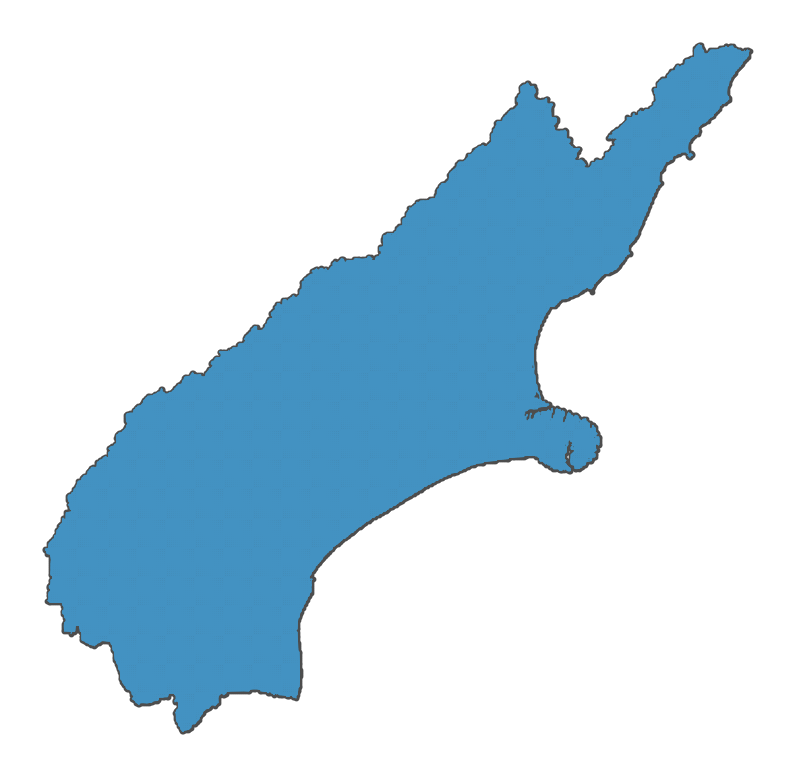

In [35]:
# Plotting to visualize spatial weights
plot_spatial_weights(wq, mbirds_nb)

In [36]:
import libpysal as lp
y = mbirds_nb['count']
ylag = lp.weights.lag_spatial(wq, y)
ylag

array([0., 0., 0., ..., 0., 0., 0.])

In [37]:
import mapclassify as mc
ylagq5 = mc.Quantiles(ylag, k=5)

/home/ztang/miniforge3/envs/deepl1/lib/python3.12/site-packages/mapclassify/classifiers.py:1653: UserWarning: Not enough unique values in array to form 5 classes. Setting k to 2.
  self.bins = quantile(y, k=k)


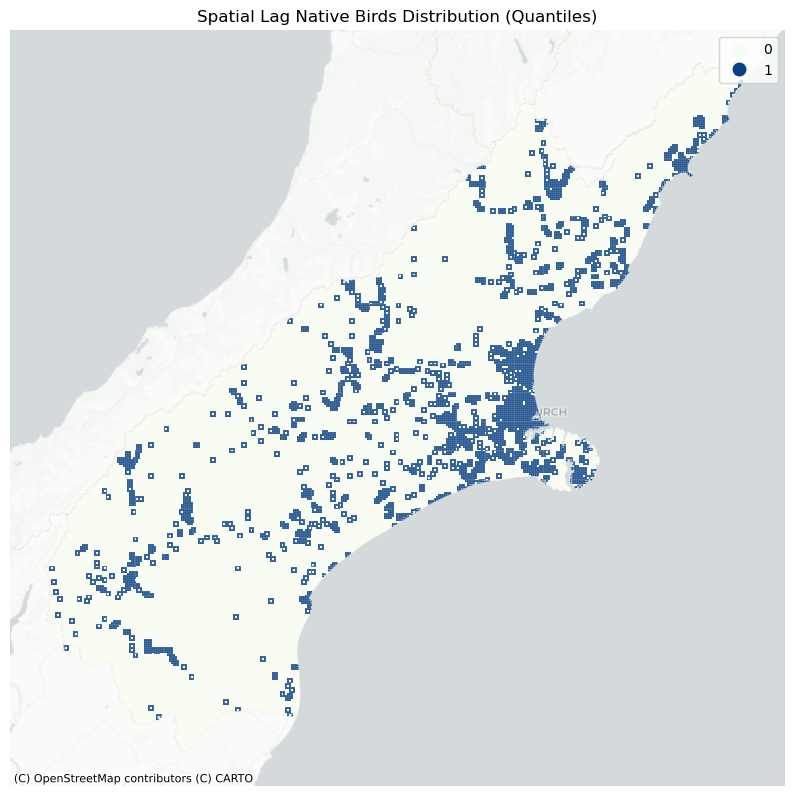

In [39]:
import contextily as ctx
f, ax = plt.subplots(1, figsize=(10, 10))
mbirds_nb.assign(cl=ylagq5.yb).plot(column='cl', categorical=True, \
        k=5, cmap='GnBu', linewidth=0.1, ax=ax, \
        edgecolor='white', legend=True)

ax.set_axis_off()
plt.title("Spatial Lag Native Birds Distribution (Quantiles)")

# add a basemap
ctx.add_basemap(ax, crs='epsg:2193', source=ctx.providers.CartoDB.Positron)

plt.show()

In [40]:
mbirds_nb['lag_count'] = ylag

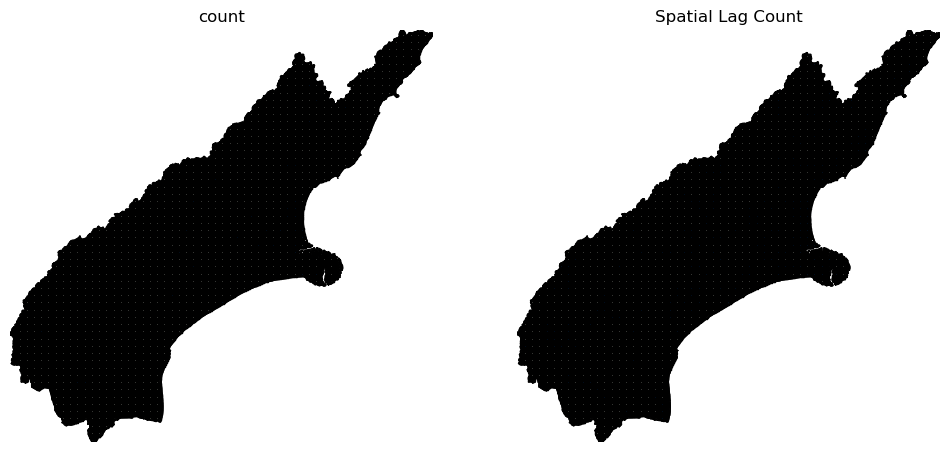

In [41]:
f,ax = plt.subplots(1,2,figsize=(12,12))
mbirds_nb.plot(column='count', ax=ax[0], edgecolor='k',
        scheme="quantiles",  k=2, cmap='GnBu')
ax[0].axis(mbirds_nb.total_bounds[np.asarray([0,2,1,3])])
ax[0].set_title("count")

mbirds_nb.plot(column='lag_count', ax=ax[1], edgecolor='k',
        scheme='quantiles', cmap='GnBu', k=2)
ax[1].axis(mbirds_nb.total_bounds[np.asarray([0,2,1,3])])
ax[1].set_title("Spatial Lag Count")
ax[0].axis('off')
ax[1].axis('off')
plt.show()

In [42]:
wq.weights

{0: [1.0, 1.0, 1.0],
 1: [1.0, 1.0, 1.0],
 2: [1.0],
 3: [1.0, 1.0, 1.0],
 4: [1.0, 1.0, 1.0, 1.0, 1.0],
 5: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 6: [1.0, 1.0, 1.0, 1.0, 1.0],
 7: [1.0, 1.0, 1.0],
 8: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 9: [1.0, 1.0, 1.0, 1.0, 1.0],
 10: [1.0, 1.0, 1.0, 1.0, 1.0],
 11: [1.0, 1.0, 1.0, 1.0, 1.0],
 12: [1.0, 1.0, 1.0, 1.0, 1.0],
 13: [1.0, 1.0, 1.0],
 14: [1.0, 1.0, 1.0],
 15: [1.0, 1.0, 1.0, 1.0, 1.0],
 16: [1.0, 1.0, 1.0],
 17: [1.0, 1.0, 1.0, 1.0, 1.0],
 18: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 19: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 20: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 21: [1.0, 1.0, 1.0, 1.0, 1.0],
 22: [1.0, 1.0, 1.0, 1.0, 1.0],
 23: [1.0, 1.0, 1.0],
 24: [1.0, 1.0, 1.0, 1.0, 1.0],
 25: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 26: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 27: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 28: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 29: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 30: [1.0, 1.0, 1.0,

In [43]:
wq.neighbors

{0: [1, 5, 6],
 1: [0, 5, 6],
 2: [8],
 3: [17, 18, 4],
 4: [17, 18, 3, 19, 5],
 5: [0, 1, 18, 19, 4, 20, 6],
 6: [0, 1, 19, 20, 5],
 7: [8, 24, 25],
 8: [2, 7, 24, 9, 26, 25],
 9: [10, 8, 25, 26, 27],
 10: [11, 9, 26, 27, 28],
 11: [28, 10, 27, 12, 29],
 12: [13, 11, 28, 29, 30],
 13: [12, 29, 30],
 14: [32, 15, 31],
 15: [32, 16, 33, 14, 31],
 16: [32, 33, 15],
 17: [48, 49, 18, 3, 4],
 18: [3, 4, 5, 48, 17, 49, 19, 50],
 19: [4, 5, 6, 49, 18, 50, 20, 51],
 20: [50, 19, 51, 5, 6, 21, 52],
 21: [51, 20, 52, 53, 22],
 22: [52, 53, 21, 54, 23],
 23: [53, 54, 22],
 24: [7, 8, 25, 56, 57],
 25: [56, 58, 7, 8, 9, 24, 57, 26],
 26: [8, 9, 10, 27, 25, 58, 59, 57],
 27: [26, 9, 10, 11, 28, 58, 59, 60],
 28: [27, 10, 11, 12, 29, 59, 60, 61],
 29: [11, 12, 13, 28, 30, 60, 61, 62],
 30: [29, 61, 31, 12, 13, 62, 63],
 31: [32, 64, 30, 62, 63, 14, 15],
 32: [64, 33, 65, 14, 15, 16, 31, 63],
 33: [32, 64, 65, 34, 66, 16, 15],
 34: [65, 33, 66, 67, 35],
 35: [34, 67, 66, 36, 68],
 36: [35, 67, 68],


Binary Case

In [44]:
y.median()

0.0

In [45]:
yb = y > y.median()
sum(yb)

1741

In [46]:
yb = y > y.median()

#Replace the boolean values with 0 (False), 1 (True)
labels = ["0 Low", "1 High"]
yb = [labels[i] for i in 1*yb] 

#Add it as a column
mbirds_nb['yb'] = yb
mbirds_nb.head(5)

,GridID,count,geometry,lag_count,yb
0,E13235N50985,0.0,"POLYGON ((1324000 5099000, 1324000 5098080.481...",0.0,0 Low
1,E13235N50995,0.0,"POLYGON ((1324000 5099000, 1323904.629 5099000...",0.0,0 Low
2,E13245N50725,0.0,"POLYGON ((1325000 5072365.48, 1324937.248 5072...",0.0,0 Low
3,E13245N50965,0.0,"POLYGON ((1325000 5097000, 1325000 5096634.646...",0.0,0 Low
4,E13245N50975,0.0,"POLYGON ((1325000 5098000, 1325000 5097000, 13...",0.0,0 Low


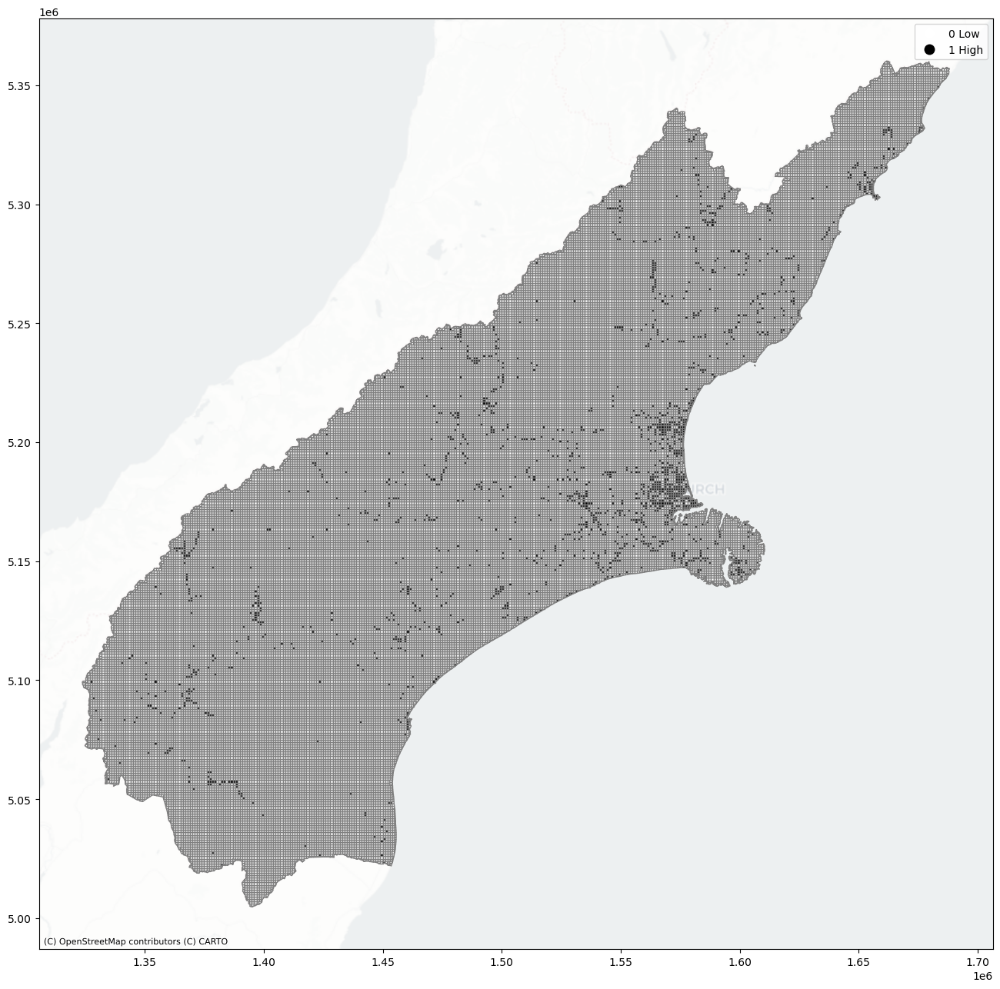

In [48]:
fig, ax = plt.subplots(figsize=(16,16), subplot_kw={'aspect':'equal'})
mbirds_nb.plot(column='yb', cmap='binary', edgecolor='grey', legend=True, ax=ax)

# add a basemap
ctx.add_basemap(ax, crs='epsg:2193', source=ctx.providers.CartoDB.Positron,alpha =0.4)

plt.show()